# Import Required Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set(style='darkgrid', font_scale=1.4)
import itertools
import plotly.express as px

# importing stacking lib
from vecstack import stacking

import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

In [2]:
import mplcyberpunk
plt.style.use("cyberpunk")

---

# Load Data

In [3]:
data = "melb_data.csv"
data_1 = "MELBOURNE_HOUSE_PRICES_LESS.csv"
data_2 = "Melbourne_housing_FULL.csv"

In [4]:
df_0 = pd.read_csv(data)
df_1 = pd.read_csv(data_1)
df = pd.read_csv(data_2)

In [5]:
print("Original data: ", df_0.shape)
print("Less data: ", df_1.shape)
print("Full data: ", df.shape)

Original data:  (13580, 21)
Less data:  (63023, 13)
Full data:  (34857, 21)


---

# Data Analysis Summary

In [6]:
df.shape

(34857, 21)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
Suburb           34857 non-null object
Address          34857 non-null object
Rooms            34857 non-null int64
Type             34857 non-null object
Price            27247 non-null float64
Method           34857 non-null object
SellerG          34857 non-null object
Date             34857 non-null object
Distance         34856 non-null float64
Postcode         34856 non-null float64
Bedroom2         26640 non-null float64
Bathroom         26631 non-null float64
Car              26129 non-null float64
Landsize         23047 non-null float64
BuildingArea     13742 non-null float64
YearBuilt        15551 non-null float64
CouncilArea      34854 non-null object
Lattitude        26881 non-null float64
Longtitude       26881 non-null float64
Regionname       34854 non-null object
Propertycount    34854 non-null float64
dtypes: float64(12), int64(1), object(8)
memory usage: 5.6+ M

### Numeric Data Descriptive Analysis

In [8]:
orig_desc = df.describe()
orig_desc

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,34857.000000,2.724700e+04,34856.000000,34856.000000,26640.000000,26631.000000,26129.000000,23047.000000,13742.00000,15551.000000,26881.000000,26881.000000,34854.000000
mean,3.031012,1.050173e+06,11.184929,3116.062859,3.084647,1.624798,1.728845,593.598993,160.25640,1965.289885,-37.810634,145.001851,7572.888306
std,0.969933,6.414671e+05,6.788892,109.023903,0.980690,0.724212,1.010771,3398.841946,401.26706,37.328178,0.090279,0.120169,4428.090313
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.00000,1196.000000,-38.190430,144.423790,83.000000
25%,2.000000,6.350000e+05,6.400000,3051.000000,2.000000,1.000000,1.000000,224.000000,102.00000,1940.000000,-37.862950,144.933500,4385.000000
50%,3.000000,8.700000e+05,10.300000,3103.000000,3.000000,2.000000,2.000000,521.000000,136.00000,1970.000000,-37.807600,145.007800,6763.000000
75%,4.000000,1.295000e+06,14.000000,3156.000000,4.000000,2.000000,2.000000,670.000000,188.00000,2000.000000,-37.754100,145.071900,10412.000000
max,16.000000,1.120000e+07,48.100000,3978.000000,30.000000,12.000000,26.000000,433014.000000,44515.00000,2106.000000,-37.390200,145.526350,21650.000000


#### Generate Numerical data

In [9]:
num_feat=df.select_dtypes(exclude='object')
num_feat.head()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
0,2,NaN,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,-37.8014,144.9958,4019.0
1,2,1480000.0,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,-37.7996,144.9984,4019.0
2,2,1035000.0,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,-37.8079,144.9934,4019.0
3,3,NaN,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,-37.8114,145.0116,4019.0
4,3,1465000.0,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,-37.8093,144.9944,4019.0


### Categorical Data Descriptive Analysis

In [10]:
df.describe(include=['O'])

,Suburb,Address,Type,Method,SellerG,Date,CouncilArea,Regionname
count,34857,34857,34857,34857,34857,34857,34854,34854
unique,351,34009,3,9,388,78,33,8
top,Reservoir,5 Charles St,h,S,Jellis,28/10/2017,Boroondara City Council,Southern Metropolitan
freq,844,6,23980,19744,3359,1119,3675,11836


#### Generate Categorical data

In [11]:
cat_feat=df.select_dtypes(include='object')
cat_feat.head()

,Suburb,Address,Type,Method,SellerG,Date,CouncilArea,Regionname
0,Abbotsford,68 Studley St,h,SS,Jellis,3/09/2016,Yarra City Council,Northern Metropolitan
1,Abbotsford,85 Turner St,h,S,Biggin,3/12/2016,Yarra City Council,Northern Metropolitan
2,Abbotsford,25 Bloomburg St,h,S,Biggin,4/02/2016,Yarra City Council,Northern Metropolitan
3,Abbotsford,18/659 Victoria St,u,VB,Rounds,4/02/2016,Yarra City Council,Northern Metropolitan
4,Abbotsford,5 Charles St,h,SP,Biggin,4/03/2017,Yarra City Council,Northern Metropolitan


### Check for Null and Duplicates values

In [12]:
df.isnull().sum()

Suburb               0
Address              0
Rooms                0
Type                 0
Price             7610
Method               0
SellerG              0
Date                 0
Distance             1
Postcode             1
Bedroom2          8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64

In [13]:
df.duplicated().sum()

1

---

# Exploratory Data Analysis (EDA)

When analyzing a dataset with the given columns, you can ask various questions to gain insights and understand the properties in the dataset. Here are some potential questions you can explore:

1. **What is the distribution of property prices?**
   - Analyze the `Price` column to understand the range, mean, median, and spread of property prices.
   - Identify any outliers or unusual patterns in the price distribution.

In [14]:
print('Mean Price', df['Price'].mean())
print('Median Price', df['Price'].median())
print('Mode Price', df['Price'].mode())

Mean Price 1050173.344955408
Median Price 870000.0
Mode Price 0     600000.0
1    1100000.0
dtype: float64


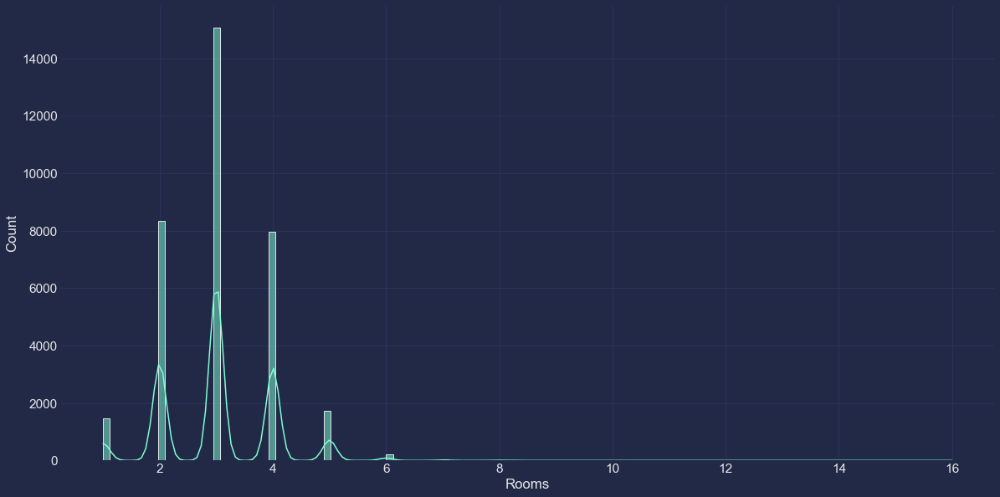

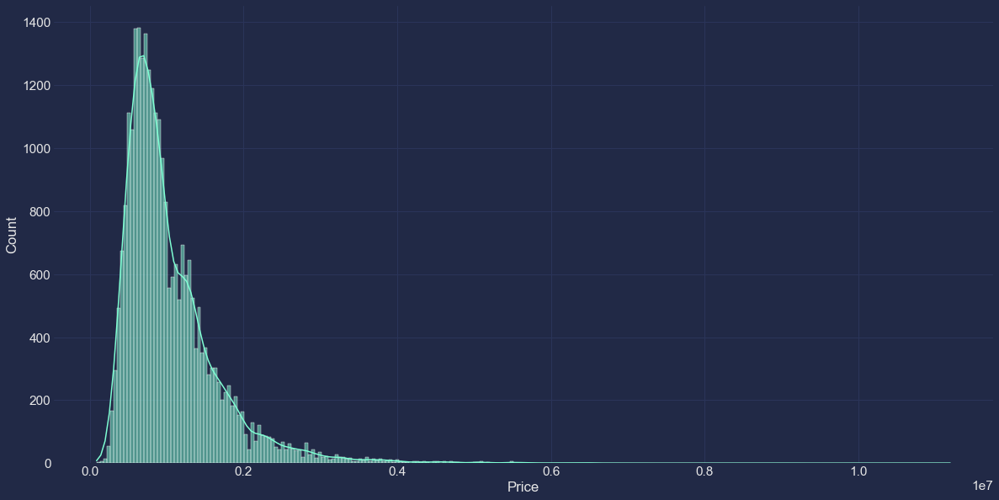

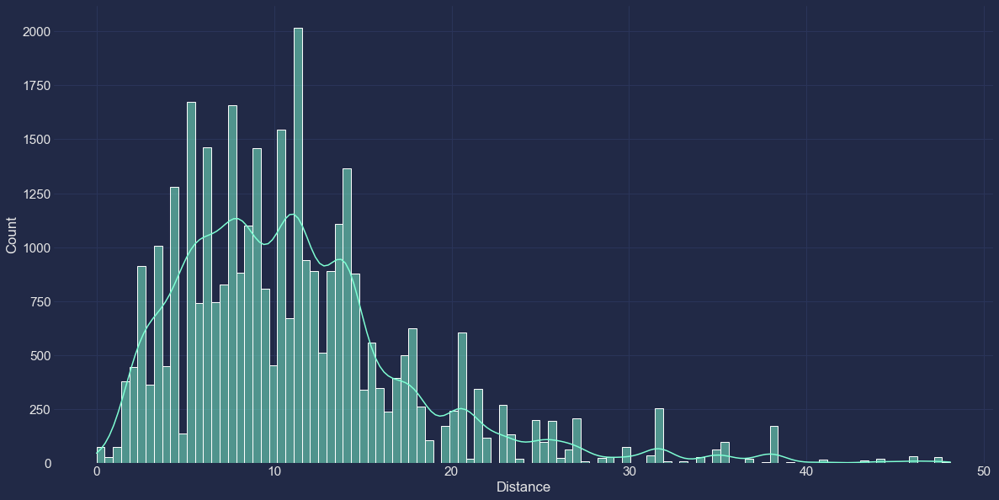

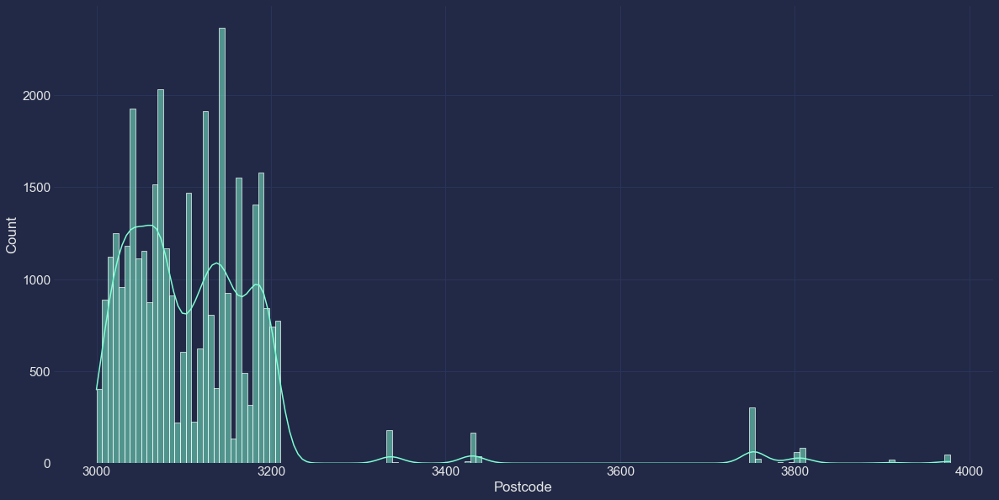

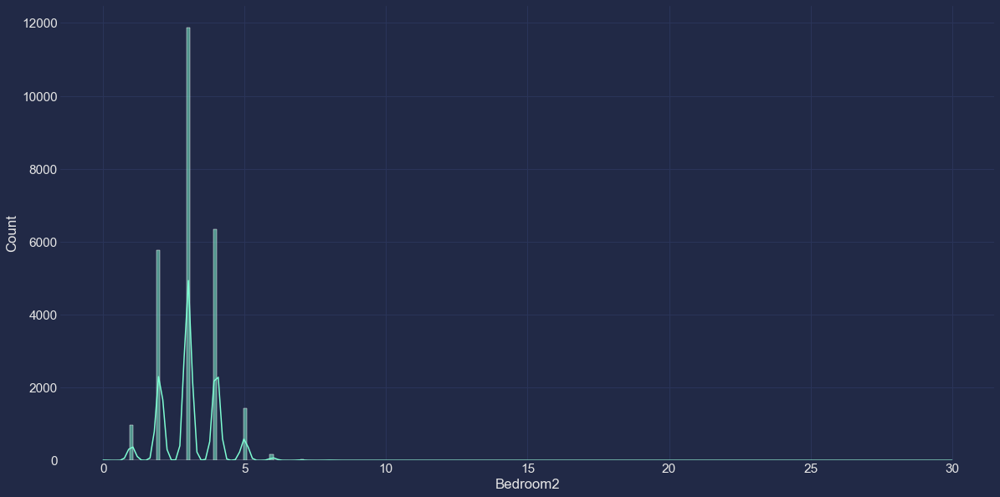

...

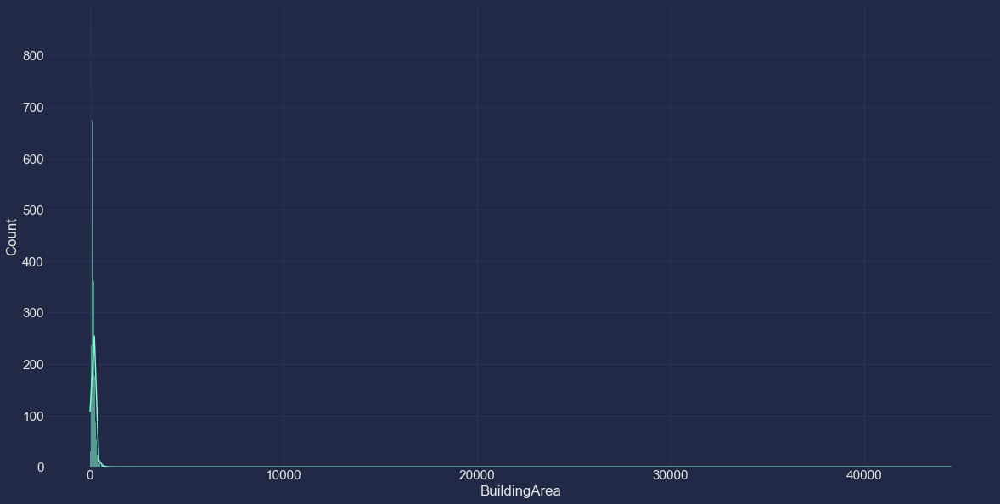

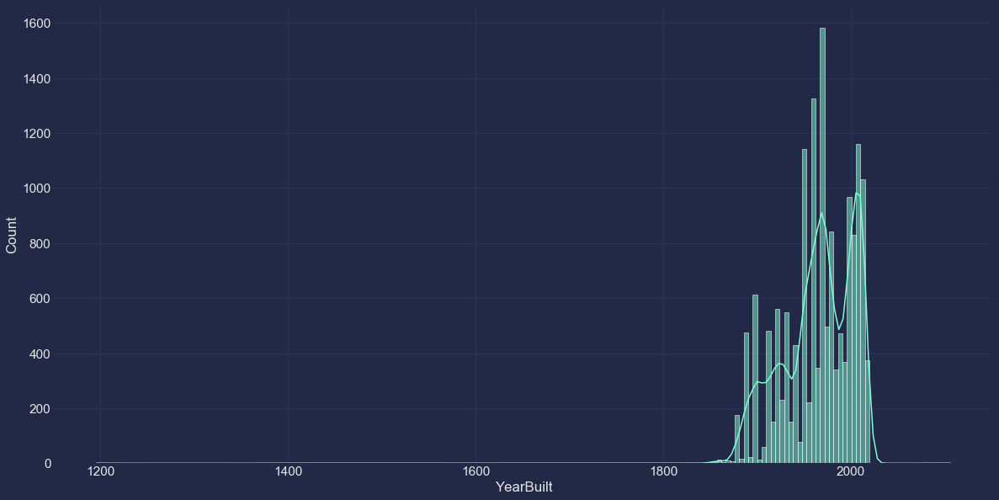

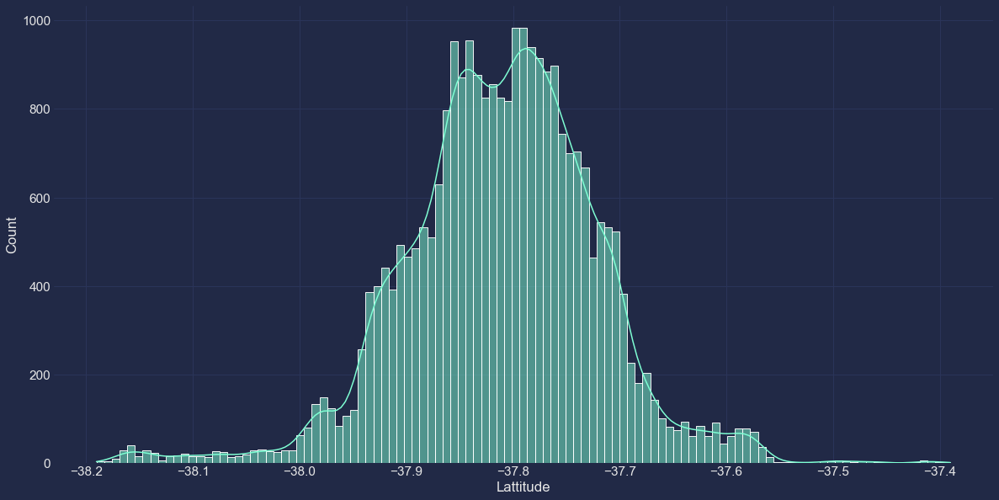

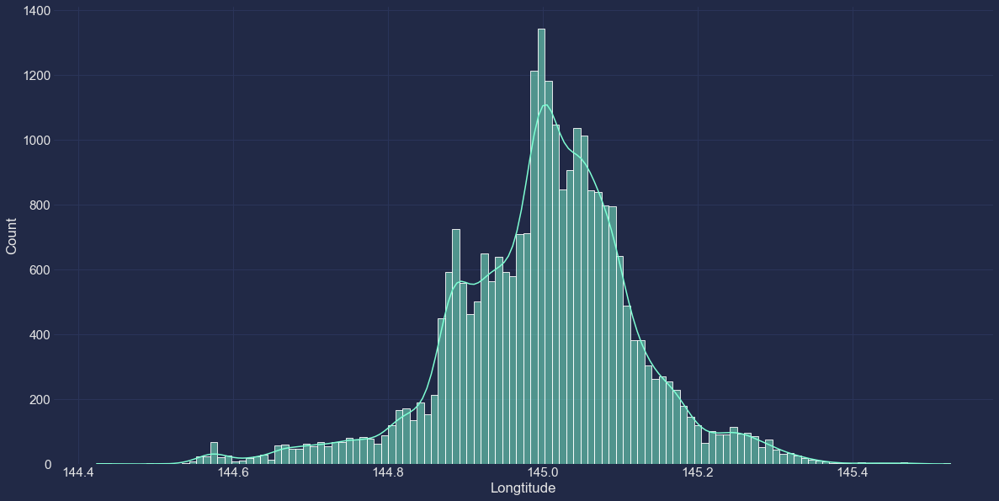

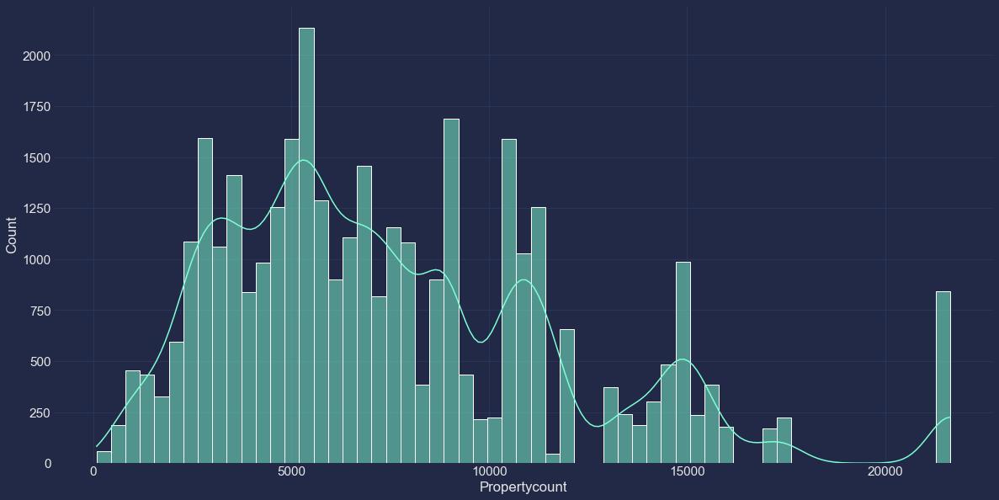

In [15]:
for i in num_feat.columns:
    plt.figure(figsize=(20,10))
    sns.histplot(num_feat[i], kde=True, color='aquamarine')
    plt.xlabel(i)
    plt.show()

**Insight:**

The price, Distance distribution is Right skewedness.

---

2. **How does the number of rooms (`Rooms`) relate to property prices (`Price`)?**
   - Explore the relationship between the number of rooms and the property prices.
   - Determine if there is a positive correlation between the two variables.

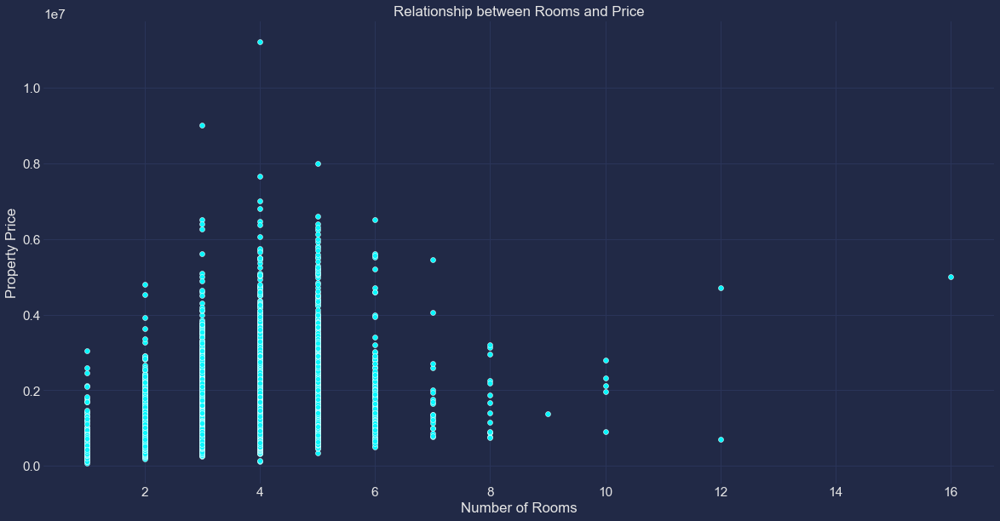

Correlation Coefficient:  0.4652383451075985


In [16]:
plt.figure(figsize=(20,10))

sns.scatterplot(data=df, x='Rooms', y='Price')
plt.xlabel('Number of Rooms')
plt.ylabel('Property Price')
plt.title('Relationship between Rooms and Price')
plt.show()

# Calculate the correlation coefficient
correlation = df['Rooms'].corr(df['Price'])
print("Correlation Coefficient: ", correlation)

---

3. **What are the different types of properties (`Type`) in the dataset?**
   - Identify the unique property types and their respective frequencies.
   - Analyze how the property type affects the prices and other attributes.

Type Frequency is:
 h    23980
u     7297
t     3580
Name: Type, dtype: int64


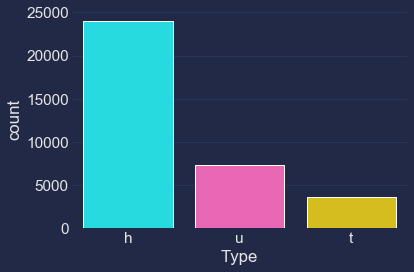

In [17]:
sns.countplot(df['Type'])

print('Type Frequency is:\n', df['Type'].value_counts())

Text(0.5, 1.0, 'Method vs Price Distribution')

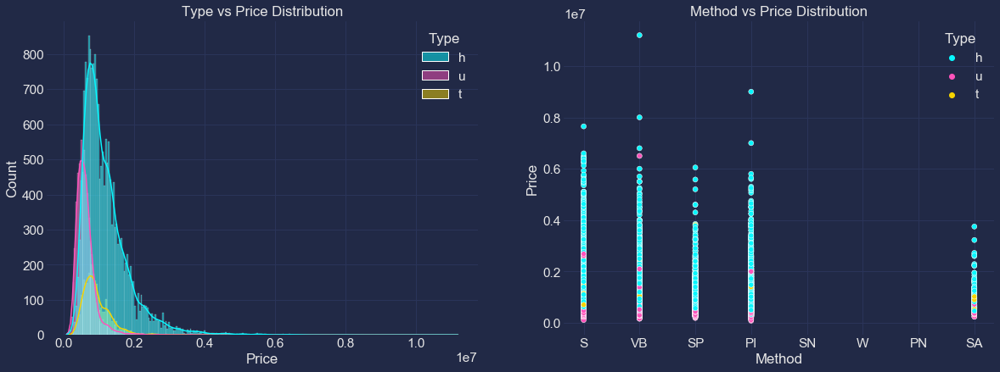

In [18]:
fig=plt.figure(figsize=(20,15))

plt.subplot(2, 2,1)
sns.histplot(data=df, x='Price', hue='Type', kde=True)
plt.title('Type vs Price Distribution')

plt.subplot(2, 2, 2)
sns.scatterplot(x='Method', y='Price', hue='Type', data=df)
plt.title('Method vs Price Distribution')

---

4. **Which suburbs (`Suburb`) have the highest property prices?**
   - Determine the suburbs with the most expensive properties.
   - Visualize the distribution of property prices across different suburbs.

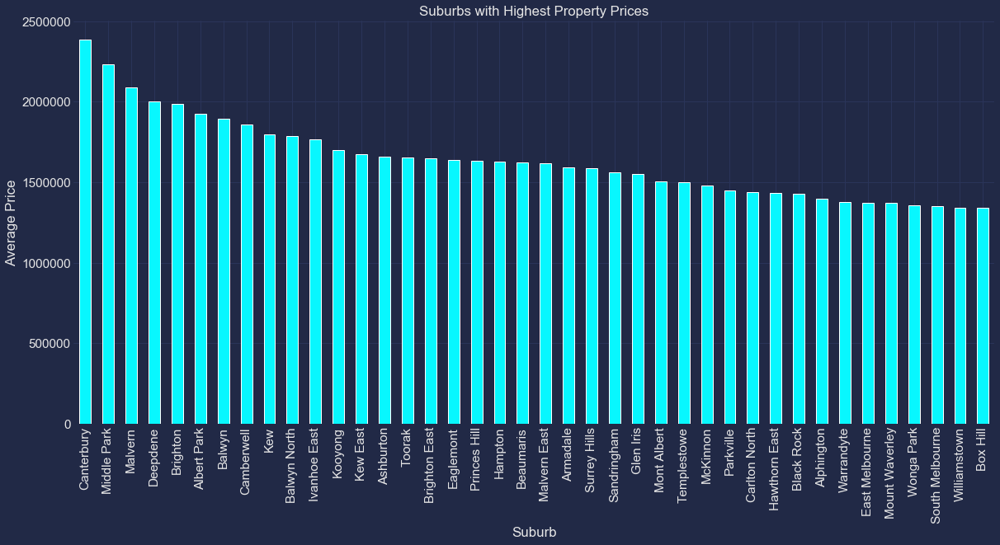

In [19]:
# Group by Suburb and calculate average property prices
suburb_prices = df.groupby('Suburb')['Price'].mean().nlargest(40)  # Adjust '10' to the desired number of suburbs to display

# Plot the suburb prices
plt.figure(figsize=(20, 9))
suburb_prices.plot(kind='bar')
plt.xlabel('Suburb')
plt.ylabel('Average Price')
plt.title('Suburbs with Highest Property Prices')
plt.xticks(rotation=90)
plt.show()


---

5. **Are there any temporal trends in property prices (`Price`) over time (`Date`)?**
   - Analyze how property prices change over different dates or time periods.
   - Identify any seasonal or long-term trends in the data.

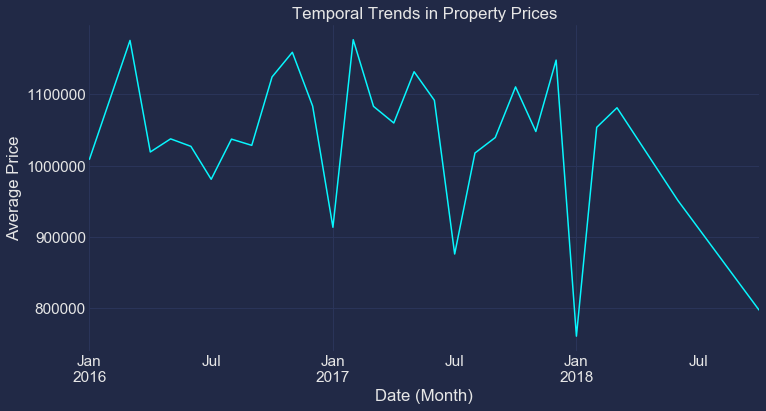

In [20]:
# Convert 'Date' column to DateTime format
df['Date'] = pd.to_datetime(df['Date'])

# Group by month and calculate average property prices
monthly_prices = df.groupby(df['Date'].dt.to_period('M'))['Price'].mean()

# Plot the time series of property prices
plt.figure(figsize=(12, 6))
monthly_prices.plot()
plt.xlabel('Date (Month)')
plt.ylabel('Average Price')
plt.title('Temporal Trends in Property Prices')
plt.show()


---

6. **What is the average land size (`Landsize`) and building area (`BuildingArea`) for different property types?**
   - Compare the average land size and building area among different property types.
   - Identify any variations or trends in the sizes of properties.

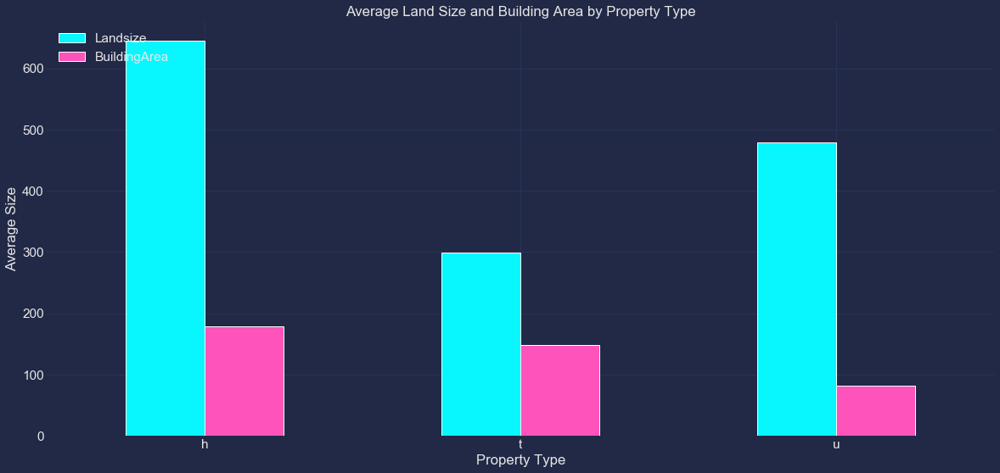

In [21]:
# Group by Property Type and calculate average land size and building area
average_sizes = df.groupby('Type')['Landsize', 'BuildingArea'].mean()

# Plot the average land size and building area
average_sizes.plot(kind='bar', figsize=(20, 9))
plt.xlabel('Property Type')
plt.ylabel('Average Size')
plt.title('Average Land Size and Building Area by Property Type')
plt.xticks(rotation=0)
plt.legend(loc='upper left')
plt.show()

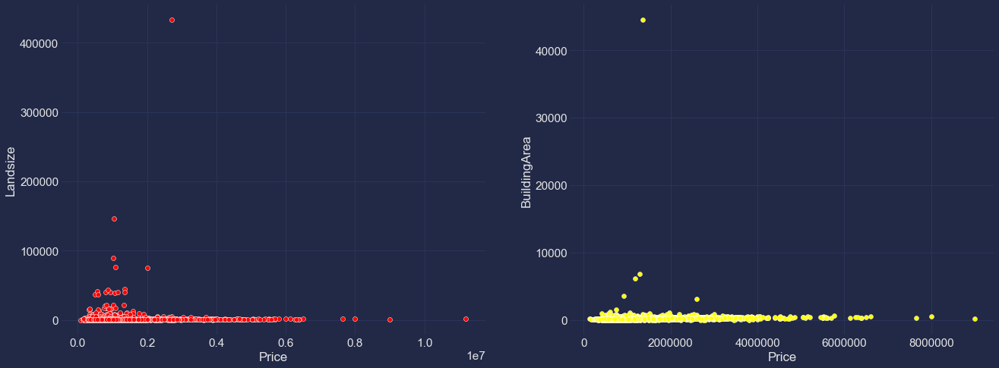

In [22]:
plt.subplots(figsize = (22, 8))
plt.subplot(1,2,1)
sns.scatterplot(x='Price', y='Landsize', data=df, color='red')

plt.subplot(1,2,2)
sns.scatterplot(x='Price', y='BuildingArea', data=df, color='yellow')

---

7. **Is there a relationship between property attributes, such as the number of bedrooms (`Bedroom2`), bathrooms (`Bathroom`), and car spaces (`Car`)?**
   - Investigate how the number of bedrooms, bathrooms, and car spaces are related.
   - Determine if certain combinations of these attributes are more common.

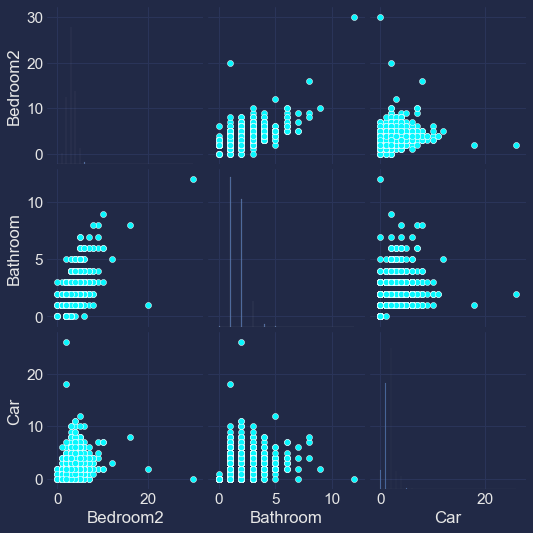

          Bedroom2  Bathroom       Car
Bedroom2  1.000000  0.614892  0.388491
Bathroom  0.614892  1.000000  0.307518
Car       0.388491  0.307518  1.000000


In [23]:
# Select the relevant columns for analysis
attributes = ['Bedroom2', 'Bathroom', 'Car']
property_data = df[attributes]

# Create a scatter matrix plot
sns.pairplot(property_data)
plt.show()

# Calculate the correlation matrix
correlation_matrix = property_data.corr()

# Display the correlation matrix
print(correlation_matrix)


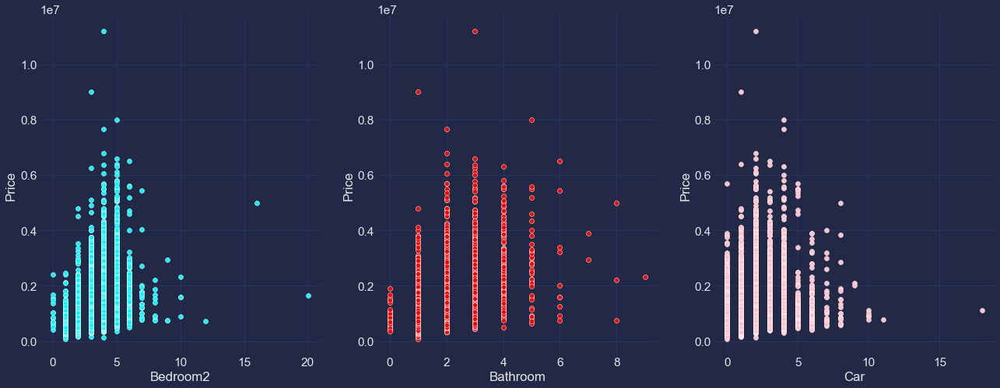

In [24]:
plt.subplots(figsize = (22, 8))

plt.subplot(1,3,1)
sns.scatterplot(x='Bedroom2', y='Price', data=df)

plt.subplot(1,3,2)
sns.scatterplot(x='Bathroom', y='Price', data=df, color='red')

plt.subplot(1,3,3)
sns.scatterplot(x='Car', y='Price', data=df, color='pink')

---

8. **Which council areas (`CouncilArea`) have the highest number of properties (`Propertycount`)?**
   - Identify the council areas with the highest property counts.
   - Analyze if property counts correlate with other factors such as location or property prices.

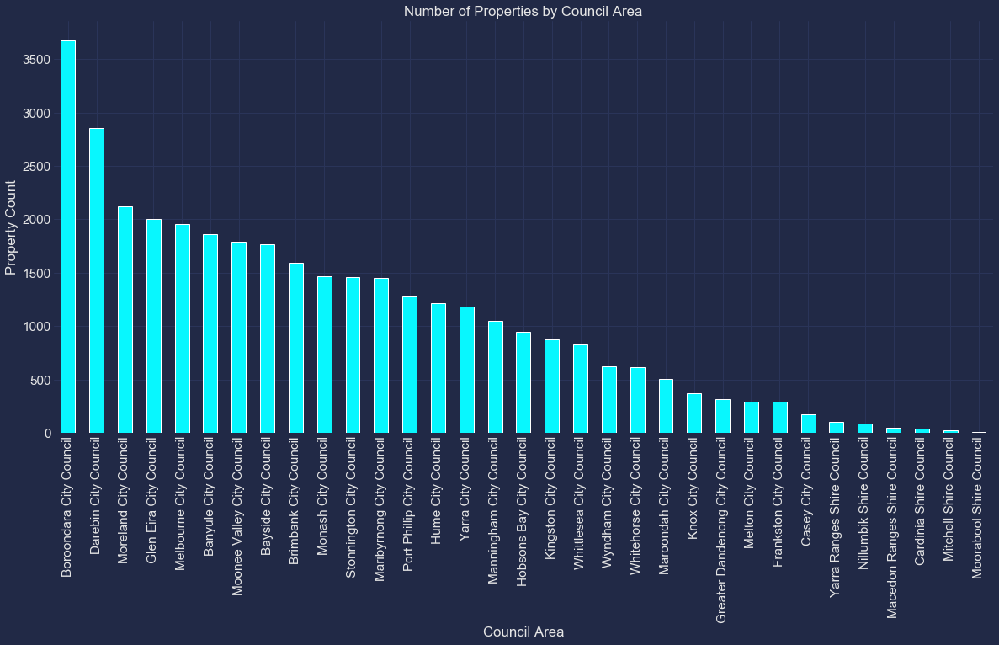

In [25]:
# Group by Council Area and count properties
property_counts = df.groupby('CouncilArea')['Propertycount'].count().sort_values(ascending=False)

# Plot the property counts
plt.figure(figsize=(20, 9))
property_counts.plot(kind='bar')
plt.xlabel('Council Area')
plt.ylabel('Property Count')
plt.title('Number of Properties by Council Area')
plt.xticks(rotation=90)
plt.show()

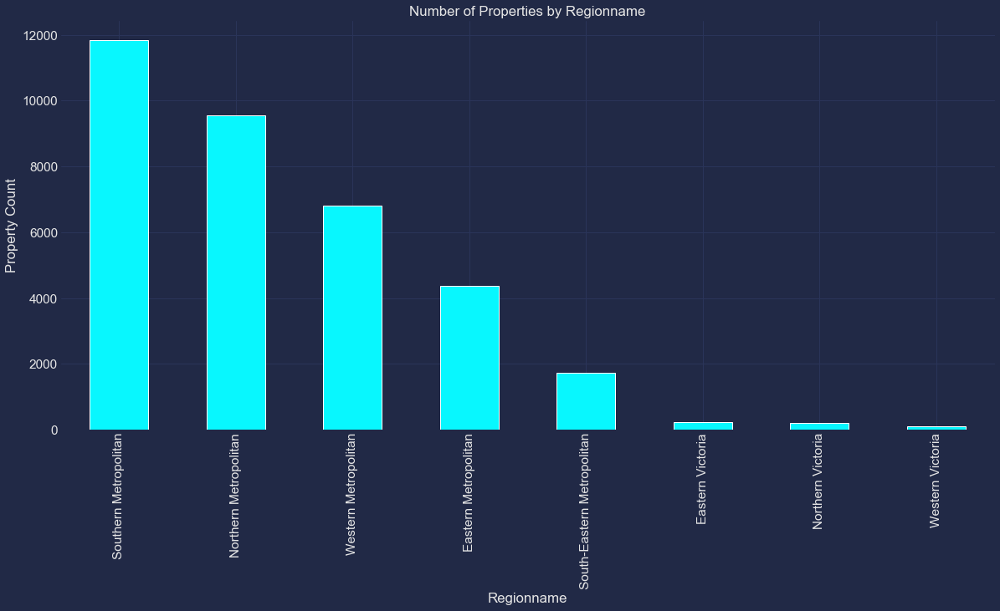

In [26]:
# Group by Council Area and count properties
property_counts = df.groupby('Regionname')['Propertycount'].count().sort_values(ascending=False)

# Plot the property counts
plt.figure(figsize=(20, 9))
property_counts.plot(kind='bar')
plt.xlabel('Regionname')
plt.ylabel('Property Count')
plt.title('Number of Properties by Regionname')
plt.xticks(rotation=90)
plt.show()

---

9. **Are there any spatial patterns in property locations (`Lattitude`, `Longtitude`) and prices (`Price`)?**
   - Visualize the property locations on a map using latitude and longitude coordinates.
   - Explore if there are any spatial patterns or clusters in property prices.

In [27]:
# Scatter plot of property locations and prices
scatter_fig = px.scatter(df, x='Longtitude', y='Lattitude', color='Price')
scatter_fig.update_layout(title='Property Locations and Prices',
                          xaxis_title='Longitude', yaxis_title='Latitude')
scatter_fig.show()

# Spatial heatmap of property prices
heatmap_fig = px.density_mapbox(df, lat='Lattitude', lon='Longtitude', z='Price',
                                radius=10, center=dict(lat=-37.8136, lon=144.9631),
                                zoom=10, mapbox_style='carto-positron')
heatmap_fig.update_layout(title='Spatial Heatmap of Property Prices')
heatmap_fig.show()

10. **How does the distance to a particular location (`Distance`) affect property prices (`Price`)?**
    - Analyze the relationship between the distance to a specific location and property prices.
    - Determine if there is a correlation or any notable patterns.

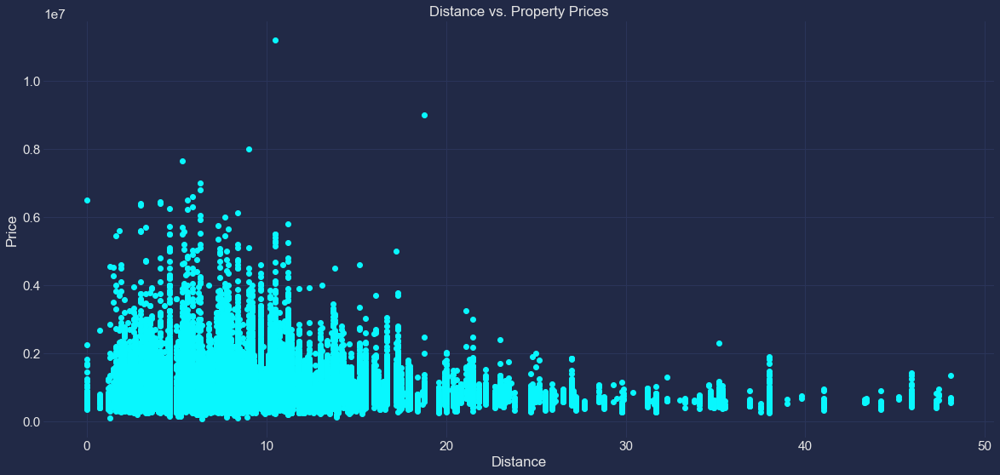

Correlation Coefficient: -0.21138434279158294


In [28]:
# Create a scatter plot or line plot of distance and property prices
plt.figure(figsize=(20, 9))
plt.scatter(df['Distance'], df['Price'])
plt.xlabel('Distance')
plt.ylabel('Price')
plt.title('Distance vs. Property Prices')
plt.show()

# Calculate the correlation coefficient
correlation_coefficient = df['Distance'].corr(df['Price'])
print('Correlation Coefficient:', correlation_coefficient)

---

## Check for Outliers

In [29]:
import numpy as np
from scipy import stats

z_scores = stats.zscore(num_feat)
outliers = np.abs(z_scores) > 2

print("Outliers: ", num_feat[outliers].columns)  # Prints the outliers
print('_'*100)
print("Numerical fetaures: ", num_feat.columns)

Outliers:  Index(['Rooms', 'Price', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude',
       'Propertycount'],
      dtype='object')
____________________________________________________________________________________________________
Numerical fetaures:  Index(['Rooms', 'Price', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude',
       'Propertycount'],
      dtype='object')


In [30]:
for i in num_feat.columns:
    fig=px.box(num_feat, y=[i])
    fig.show()

# Feature Engineering

In [31]:
# Add age variable
df['Age'] = 2017 - df['YearBuilt']

# Identify historic homes
df['Historic'] = np.where(df['Age']>=50,'Historic','Contemporary')

# Convert to Category
df['Historic'] = df['Historic'].astype('category')

In [32]:
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,Age,Historic
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,2016-03-09,2.5,3067.0,...,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0,NaN,Contemporary
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,2016-03-12,2.5,3067.0,...,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0,NaN,Contemporary
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,2016-04-02,2.5,3067.0,...,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0,117.0,Historic
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,2016-04-02,2.5,3067.0,...,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0,NaN,Contemporary
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,2017-04-03,2.5,3067.0,...,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0,117.0,Historic


### Correlational Matrix

In [33]:
corr = df.corr()
fig = px.imshow(corr, text_auto = True, aspect = 'auto')
fig.show()

# Data Cleaning

#### Impute missing data

In [34]:
df.Price = df.Price.fillna(df.Price.median())
df.Distance = df.Distance.fillna(df.Distance.median())
df.Postcode = df.Postcode.fillna(df.Postcode.median())
df.Bedroom2 = df.Bedroom2.fillna(df.Bedroom2.median())
df.Bathroom=df.Bathroom.fillna(df.Bathroom.median())
df.BuildingArea=df.BuildingArea.fillna(df.BuildingArea.median())
df.Car=df.Car.fillna(df.Car.median())
df.Landsize=df.Landsize.fillna(df.Landsize.median())
df.BuildingArea=df.BuildingArea.fillna(df.BuildingArea.median())
df.YearBuilt=df.YearBuilt.fillna(df.YearBuilt.median())
df.Lattitude=df.Lattitude.fillna(df.Lattitude.median())
df.Longtitude=df.Longtitude.fillna(df.Longtitude.median())
df.Propertycount=df.Propertycount.fillna(df.Propertycount.median())
df.Age=df.Age.fillna(df.Age.median())

In [35]:
df['CouncilArea']=df['CouncilArea'].fillna(df['CouncilArea'].value_counts().index[0])
df['Regionname']=df['Regionname'].fillna(df['Regionname'].value_counts().index[0])

In [36]:
df.isnull().sum()

Suburb           0
Address          0
Rooms            0
Type             0
Price            0
Method           0
SellerG          0
Date             0
Distance         0
Postcode         0
Bedroom2         0
Bathroom         0
Car              0
Landsize         0
BuildingArea     0
YearBuilt        0
CouncilArea      0
Lattitude        0
Longtitude       0
Regionname       0
Propertycount    0
Age              0
Historic         0
dtype: int64

#### Outliers handling

In [37]:
outliers=num_feat

In [38]:
for i in outliers:
    minimum,q1,middle,q3,maximum=np.quantile(df[i],[0,0.25,0.50,0.75,1])
    IQR=q3-q1
    lower_fence=q1-(IQR*1.5)
    higher_fence=q3+(IQR*1.5)
    print("In "+i+" Column any values beyond the Range "+str(lower_fence)+" and "+str(higher_fence)+" are outliers")

In Rooms Column any values beyond the Range -1.0 and 7.0 are outliers
In Price Column any values beyond the Range 12500.0 and 1832500.0 are outliers
In Distance Column any values beyond the Range -4.999999999999998 and 25.4 are outliers
In Postcode Column any values beyond the Range 2893.5 and 3313.5 are outliers
In Bedroom2 Column any values beyond the Range 3.0 and 3.0 are outliers
In Bathroom Column any values beyond the Range -0.5 and 3.5 are outliers
In Car Column any values beyond the Range -0.5 and 3.5 are outliers
In Landsize Column any values beyond the Range -4.5 and 959.5 are outliers
In BuildingArea Column any values beyond the Range 136.0 and 136.0 are outliers
In YearBuilt Column any values beyond the Range 1970.0 and 1970.0 are outliers
In Lattitude Column any values beyond the Range -37.960899999999995 and -37.65689999999999 are outliers
In Longtitude Column any values beyond the Range 144.83337500000005 and 145.182775 are outliers
In Propertycount Column any values bey

In [39]:
orig_desc

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,34857.000000,2.724700e+04,34856.000000,34856.000000,26640.000000,26631.000000,26129.000000,23047.000000,13742.00000,15551.000000,26881.000000,26881.000000,34854.000000
mean,3.031012,1.050173e+06,11.184929,3116.062859,3.084647,1.624798,1.728845,593.598993,160.25640,1965.289885,-37.810634,145.001851,7572.888306
std,0.969933,6.414671e+05,6.788892,109.023903,0.980690,0.724212,1.010771,3398.841946,401.26706,37.328178,0.090279,0.120169,4428.090313
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.00000,1196.000000,-38.190430,144.423790,83.000000
25%,2.000000,6.350000e+05,6.400000,3051.000000,2.000000,1.000000,1.000000,224.000000,102.00000,1940.000000,-37.862950,144.933500,4385.000000
50%,3.000000,8.700000e+05,10.300000,3103.000000,3.000000,2.000000,2.000000,521.000000,136.00000,1970.000000,-37.807600,145.007800,6763.000000
75%,4.000000,1.295000e+06,14.000000,3156.000000,4.000000,2.000000,2.000000,670.000000,188.00000,2000.000000,-37.754100,145.071900,10412.000000
max,16.000000,1.120000e+07,48.100000,3978.000000,30.000000,12.000000,26.000000,433014.000000,44515.00000,2106.000000,-37.390200,145.526350,21650.000000


### Encode

In [40]:
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler

In [41]:
# drop features
drop_list = ['Suburb', 'Address', 'SellerG', 'CouncilArea']
df = df.drop(drop_list, axis=1)

In [42]:
df[['Type', 'Method', 'Regionname']].isna().sum()

Type          0
Method        0
Regionname    0
dtype: int64

In [43]:
# one-hot encoding
# set sparse=False to return an array
cat_encoder = OneHotEncoder(sparse=False)
df_type_reshaped = df['Type'].values.reshape(-1,1)
df_type_1hot = cat_encoder.fit_transform(df_type_reshaped)
categories = cat_encoder.categories_
df_type_1hot = pd.DataFrame(df_type_1hot, columns=categories)

# concat 1hot DataFrame w/ df_na
# reset index of df_na and concat
df = df.reset_index().drop('index', axis=1)
df = pd.concat([df, df_type_1hot], axis=1)
df.head()

,Rooms,Type,Price,Method,Date,Distance,Postcode,Bedroom2,Bathroom,Car,...,YearBuilt,Lattitude,Longtitude,Regionname,Propertycount,Age,Historic,"(h,)","(t,)","(u,)"
0,2,h,870000.0,SS,2016-03-09,2.5,3067.0,2.0,1.0,1.0,...,1970.0,-37.8014,144.9958,Northern Metropolitan,4019.0,47.0,Contemporary,1.0,0.0,0.0
1,2,h,1480000.0,S,2016-03-12,2.5,3067.0,2.0,1.0,1.0,...,1970.0,-37.7996,144.9984,Northern Metropolitan,4019.0,47.0,Contemporary,1.0,0.0,0.0
2,2,h,1035000.0,S,2016-04-02,2.5,3067.0,2.0,1.0,0.0,...,1900.0,-37.8079,144.9934,Northern Metropolitan,4019.0,117.0,Historic,1.0,0.0,0.0
3,3,u,870000.0,VB,2016-04-02,2.5,3067.0,3.0,2.0,1.0,...,1970.0,-37.8114,145.0116,Northern Metropolitan,4019.0,47.0,Contemporary,0.0,0.0,1.0
4,3,h,1465000.0,SP,2017-04-03,2.5,3067.0,3.0,2.0,0.0,...,1900.0,-37.8093,144.9944,Northern Metropolitan,4019.0,117.0,Historic,1.0,0.0,0.0


In [44]:
# one-hot encode 'Method' feature
df_meth_reshaped = df['Method'].values.reshape(-1,1)
df_meth_1hot = cat_encoder.fit_transform(df_meth_reshaped)
categories = cat_encoder.categories_
df_meth_1hot = pd.DataFrame(df_meth_1hot, columns=categories)

# concat 1hot DataFrame w/ df_na
df = pd.concat([df, df_meth_1hot], axis=1)
df.head()

,Rooms,Type,Price,Method,Date,Distance,Postcode,Bedroom2,Bathroom,Car,...,"(u,)","(PI,)","(PN,)","(S,)","(SA,)","(SN,)","(SP,)","(SS,)","(VB,)","(W,)"
0,2,h,870000.0,SS,2016-03-09,2.5,3067.0,2.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,2,h,1480000.0,S,2016-03-12,2.5,3067.0,2.0,1.0,1.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,h,1035000.0,S,2016-04-02,2.5,3067.0,2.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,u,870000.0,VB,2016-04-02,2.5,3067.0,3.0,2.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,3,h,1465000.0,SP,2017-04-03,2.5,3067.0,3.0,2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [45]:
# one-hot encode 'Regionname' feature
df_reg_reshaped = df['Regionname'].values.reshape(-1,1)
df_reg_1hot = cat_encoder.fit_transform(df_reg_reshaped)
categories = cat_encoder.categories_
df_reg_1hot = pd.DataFrame(df_reg_1hot, columns=categories)

# concat 1hot DataFrame w/ df_na
df = pd.concat([df, df_reg_1hot], axis=1)
df.head()

,Rooms,Type,Price,Method,Date,Distance,Postcode,Bedroom2,Bathroom,Car,...,"(VB,)","(W,)","(Eastern Metropolitan,)","(Eastern Victoria,)","(Northern Metropolitan,)","(Northern Victoria,)","(South-Eastern Metropolitan,)","(Southern Metropolitan,)","(Western Metropolitan,)","(Western Victoria,)"
0,2,h,870000.0,SS,2016-03-09,2.5,3067.0,2.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,2,h,1480000.0,S,2016-03-12,2.5,3067.0,2.0,1.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,2,h,1035000.0,S,2016-04-02,2.5,3067.0,2.0,1.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,3,u,870000.0,VB,2016-04-02,2.5,3067.0,3.0,2.0,1.0,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4,3,h,1465000.0,SP,2017-04-03,2.5,3067.0,3.0,2.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [46]:
# drop features
drop_list2 = ['Type', 'Method', 'Regionname', 'Date', 'Historic']
df = df.drop(drop_list2, axis=1)

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 34 columns):
Rooms                            34857 non-null int64
Price                            34857 non-null float64
Distance                         34857 non-null float64
Postcode                         34857 non-null float64
Bedroom2                         34857 non-null float64
Bathroom                         34857 non-null float64
Car                              34857 non-null float64
Landsize                         34857 non-null float64
BuildingArea                     34857 non-null float64
YearBuilt                        34857 non-null float64
Lattitude                        34857 non-null float64
Longtitude                       34857 non-null float64
Propertycount                    34857 non-null float64
Age                              34857 non-null float64
(h,)                             34857 non-null float64
(t,)                             34857 non-null float

---

# Pre- process & Build Model

In [54]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import cross_val_score, KFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from scipy.stats import mstats

In [49]:
# Apply the pipeline to dataset
X = df.drop('Price', axis=1)
y = np.log(df['Price']) #normalize dependent variable 

In [ ]:
# Perform train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)